In [2]:
from load_data import parameters_dict, simulation_file_paths

import numpy as np
# import saved feature array
feature_arr = np.load("feature_arr.npy")

In [3]:
# check gpu
import tensorflow as tf
print("Num GPUs Available: ", len(
    tf.config.experimental.list_physical_devices('GPU')))

2024-04-10 09:29:52.130066: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-10 09:29:52.840756: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Num GPUs Available:  1


2024-04-10 09:29:53.223994: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-04-10 09:29:53.248007: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-04-10 09:29:53.248276: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [4]:
from sklearn.cluster import DBSCAN


# function that returns the std of the distance between the centroids of the clusters
def std_distance_centroids(feature_arr, cluster_labels):
    centroids =[] 
    # fill the array with the centroids
    for i in cluster_labels:
        centroids.append(np.mean(feature_arr[cluster_labels == i], axis=0))
    # initialize the array that will contain the distances
    distances =[] 
    # fill the array with the distances
    for i in range(len(centroids)):
        for j in range(len(centroids)):
            distances.append(np.linalg.norm(centroids[i] - centroids[j]))
    # return the std of the distances
    return np.std(distances)

In [5]:
import optuna


def objective(trial):
    eps = trial.suggest_float("eps", 0.5, 1.5)
    min_samples = trial.suggest_int("min_samples", 2, 10)
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = dbscan.fit_predict(feature_arr)
    std_dist = std_distance_centroids(feature_arr, cluster_labels)
    return std_dist


study = optuna.create_study(direction="minimize", study_name="dbscan_centroids_min_cv",
                            storage="sqlite:///test.db", load_if_exists=True)
study.optimize(objective, n_trials=100)

[I 2024-04-10 09:29:54,093] A new study created in RDB with name: dbscan_centroids_min_cv
[I 2024-04-10 09:30:21,152] Trial 0 finished with value: 76.39055633544922 and parameters: {'eps': 1.0961294161643886, 'min_samples': 9}. Best is trial 0 with value: 76.39055633544922.
[I 2024-04-10 09:30:47,547] Trial 1 finished with value: 100.09003448486328 and parameters: {'eps': 1.4190787832190566, 'min_samples': 3}. Best is trial 0 with value: 76.39055633544922.
[I 2024-04-10 09:31:13,805] Trial 2 finished with value: 97.41361236572266 and parameters: {'eps': 1.173800165652978, 'min_samples': 3}. Best is trial 0 with value: 76.39055633544922.
[I 2024-04-10 09:31:40,017] Trial 3 finished with value: 86.01737213134766 and parameters: {'eps': 0.999510484710197, 'min_samples': 6}. Best is trial 0 with value: 76.39055633544922.
[I 2024-04-10 09:32:06,330] Trial 4 finished with value: 86.95049285888672 and parameters: {'eps': 1.4023111832359891, 'min_samples': 8}. Best is trial 0 with value: 76.39

In [6]:
dbscan = DBSCAN(eps=study.best_params["eps"], min_samples=study.best_params["min_samples"])

dbscan.fit(feature_arr)
print(len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0))

import plotly.graph_objs as go
import plotly.express as ptx

class_dict = {f"Class {i}": list() for i in range(len(set(dbscan.labels_)))}
class_dict["Outliers"] = list()
for index, path in enumerate(simulation_file_paths):
    class_ = dbscan.labels_[index]
    if class_ == -1:
        class_dict["Outliers"].append(str(path))
    else:
        class_dict[f"Class {class_}"].append(str(path))

traces = list()
for class_id, colour in zip(class_dict, ptx.colors.qualitative.Dark24):
    traces.append(
        go.Scatter(
            x=[
                parameters_dict[f]["H"]
                for f in class_dict[class_id]
            ],
            y=[
                parameters_dict[f]["E"]
                for f in class_dict[class_id]
            ],
            mode="markers",
            name=class_id,
            opacity=0.7,
            marker=dict(
                size=11,
                color=colour,
            ),
        )
    )

fig = go.Figure(data=traces)
fig.update_layout(
    autosize=False,
    width=990,
    height=600,
    margin=dict(
        l=10,
        r=10,
        b=25,
        t=25,
    ),
    xaxis_title=r"$\mu_0 \mathbf{H} \text{ (T)}$",
    yaxis_title=r"$\Delta \text{E (J)}$",
)

59


ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'marker': {'color': '#2E91E5', 'size': 11},
              'mode': 'markers',
              'name': 'Class 0',
              'opacity': 0.7,
              'type': 'scatter',
              'x': [0.6698909203044445, 0.6698909203044445, 0.6698909203044445,
                    0.6698909203044445, 0.6698909203044445, 0.6698909203044445,
                    0.6698909203044445, 0.6699039315395161, 0.6699039315395161,
                    0.6699039315395161, 0.6699039315395161, 0.6699039315395161,
                    0.6699039315395161, 0.6699039315395161, 0.6742951967549535,
                    0.6742951967549535, 0.6742951967549535, 0.6742951967549535,
                    0.6742951967549535, 0.6742951967549535, 0.6742951967549535],
              'y': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                    0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]},
             {'marker': {'color': '#E15F99', 'size': 11},
              'mode': 'markers',
              'name': 'Class 1',
              'opacity': 0.7,
              'type': 'scatter',
              'x': [0.55779369174165, 0.55779369174165, 0.55779369174165,
                    0.55779369174165, 0.55779369174165, 0.55779369174165,
                    0.55779369174165, 0.55779369174165, 0.5536843308215675,
                    0.5536843308215675, 0.5536843308215675, 0.5536843308215675,
                    0.5536843308215675, 0.5536843308215675, 0.5536843308215675,
                    0.5536843308215675, 0.554693781571518, 0.554693781571518,
                    0.554693781571518, 0.554693781571518, 0.554693781571518,
                    0.554693781571518, 0.554693781571518, 0.554693781571518],
              'y': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                    0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]},
             {'marker': {'color': '#1CA71C', 'size': 11},
              'mode': 'markers',
              'name': 'Class 2',
              'opacity': 0.7,
              'type': 'scatter',
              'x': [0.5823933515367479, 0.5823933515367479, 0.5823933515367479,
                    0.5823933515367479, 0.5823933515367479, 0.5823933515367479,
                    0.5823933515367479, 0.5823933515367479, 0.5814367798799912,
                    0.5814367798799912, 0.5814367798799912, 0.5814367798799912,
                    0.5814367798799912, 0.5814367798799912, 0.5814367798799912,
                    0.5814367798799912, 0.5785806608969681, 0.5785806608969681,
                    0.5785806608969681, 0.5785806608969681, 0.5785806608969681,
                    0.5785806608969681, 0.5785806608969681, 0.5785806608969681,
                    0.5851306000927129, 0.5851306000927129, 0.5851306000927129,
                    0.5851306000927129, 0.5851306000927129, 0.5851306000927129,
                    0.5851306000927129, 0.5851306000927129],
              'y': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                    0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
                    0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]},
             {'marker': {'color': '#FB0D0D', 'size': 11},
              'mode': 'markers',
              'name': 'Class 3',
              'opacity': 0.7,
              'type': 'scatter',
              'x': [0.7108584663581602, 0.7108584663581602, 0.7108584663581602,
                    0.7108584663581602, 0.7108584663581602, 0.7108584663581602,
                    0.7108584663581602, 0.7125494922138771, 0.7125494922138771,
                    0.7125494922138771, 0.7125494922138771, 0.7125494922138771,
                    0.7125494922138771, 0.7125494922138771, 0.720271961003612,
                    0.720271961003612, 0.720271961003612, 0.720271961003612,
                    0.720271961003612, 0.720271961003612, 0.720271961003612,
                    0.7179679094332169, 0.7179679094332169, 0.7179679094332169,
                    0.7179679094332169, 

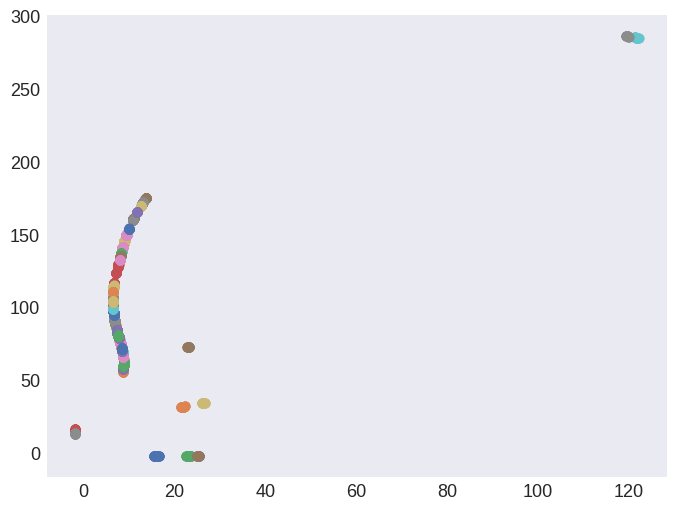

In [7]:
# plot the feature space in 3d color coded by the cluster
import matplotlib.pyplot as plt
for i in range(len(set(dbscan.labels_))):
    plt.scatter(feature_arr[dbscan.labels_ == i, 0], feature_arr[dbscan.labels_ == i, 1], label=f"Cluster {i}")
plt.show()

/home/tux/optim/plotting.py:199: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



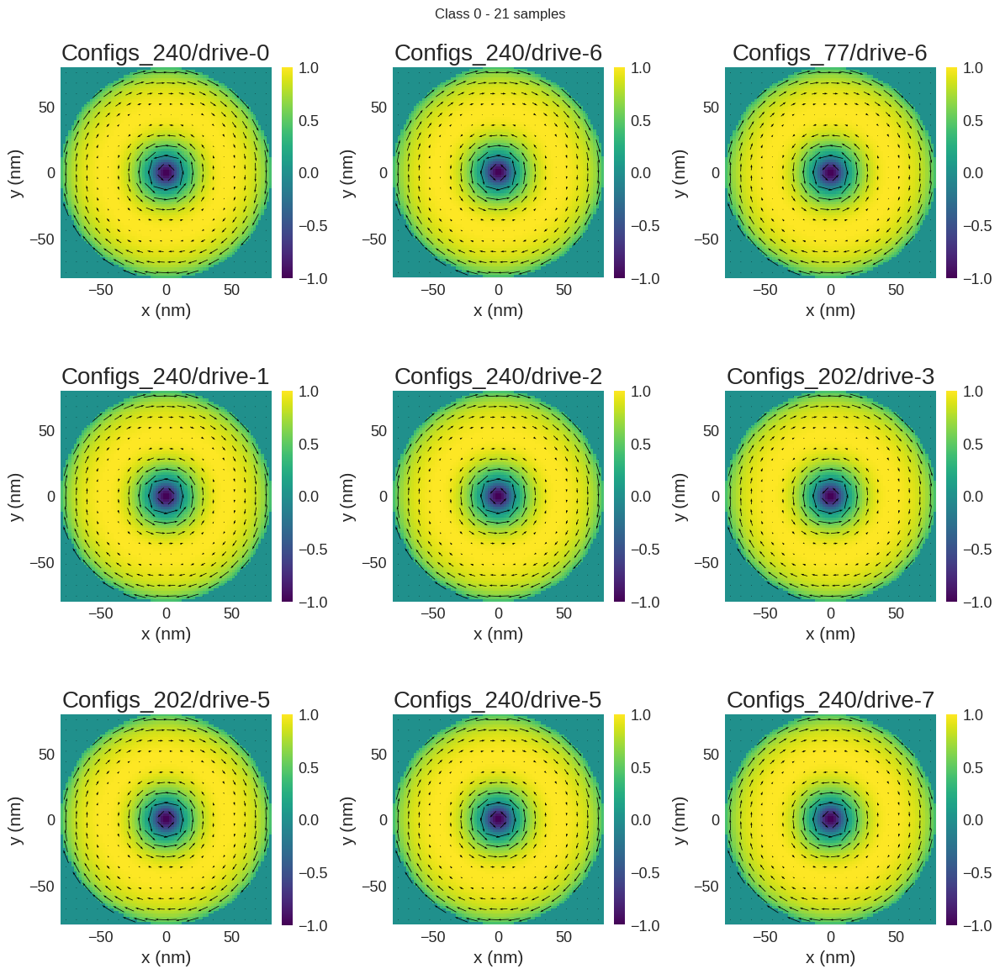

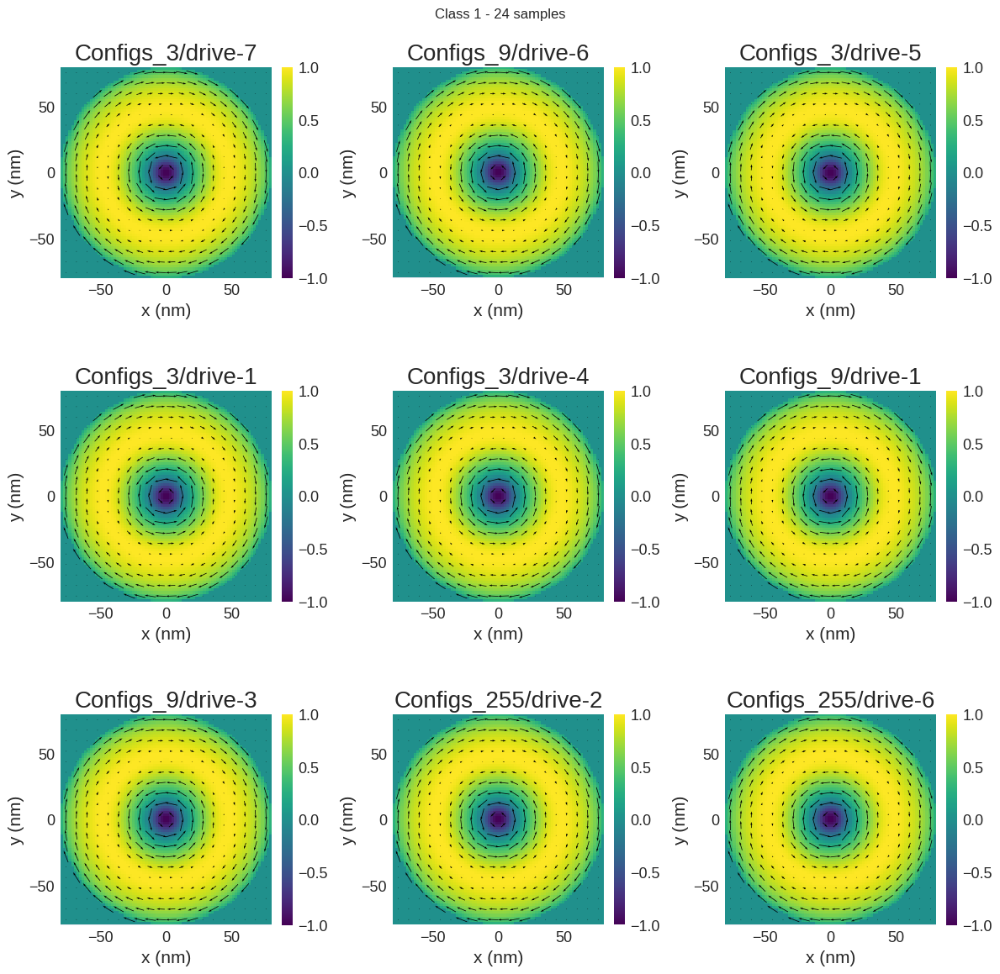

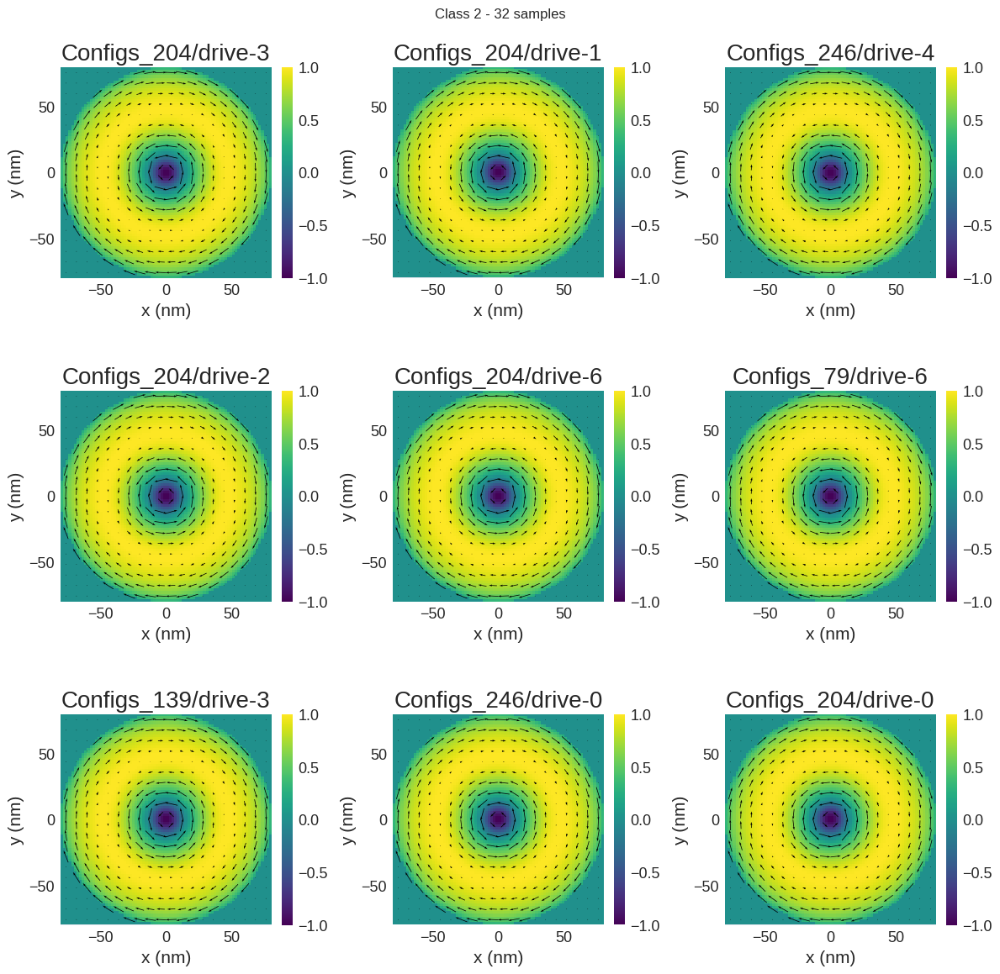

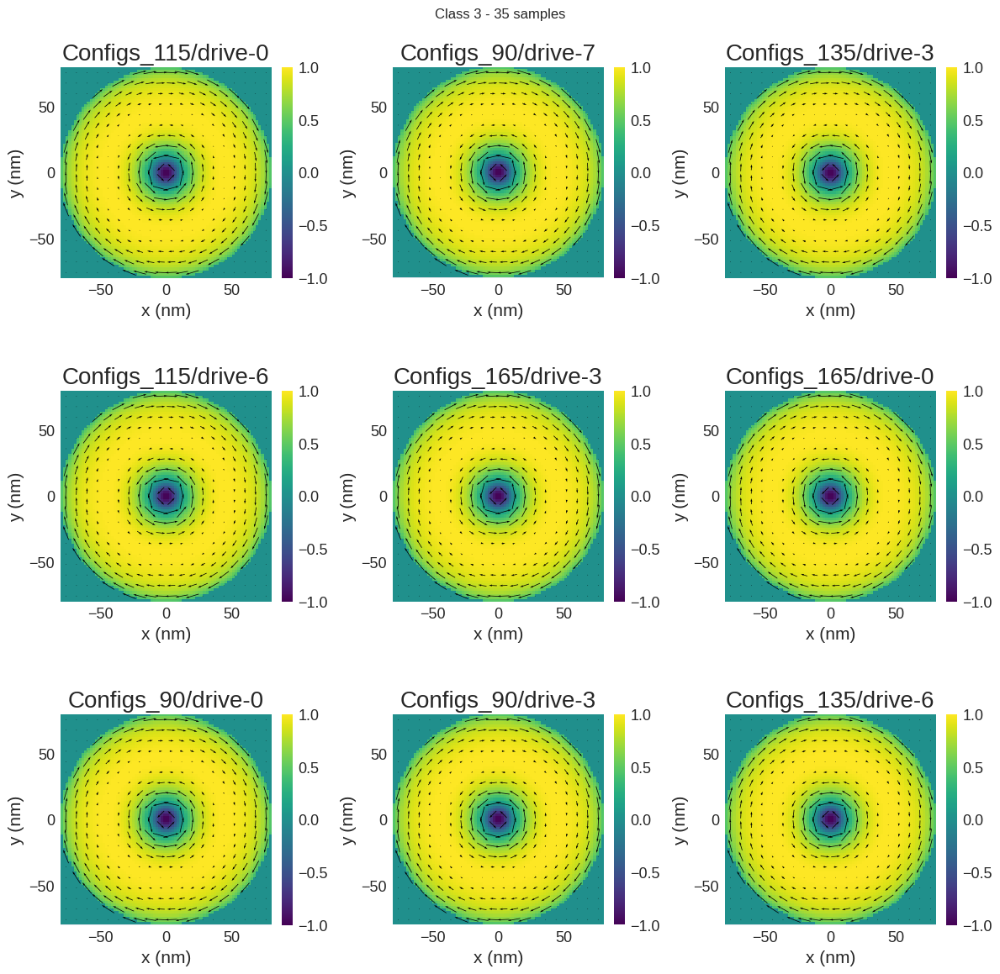

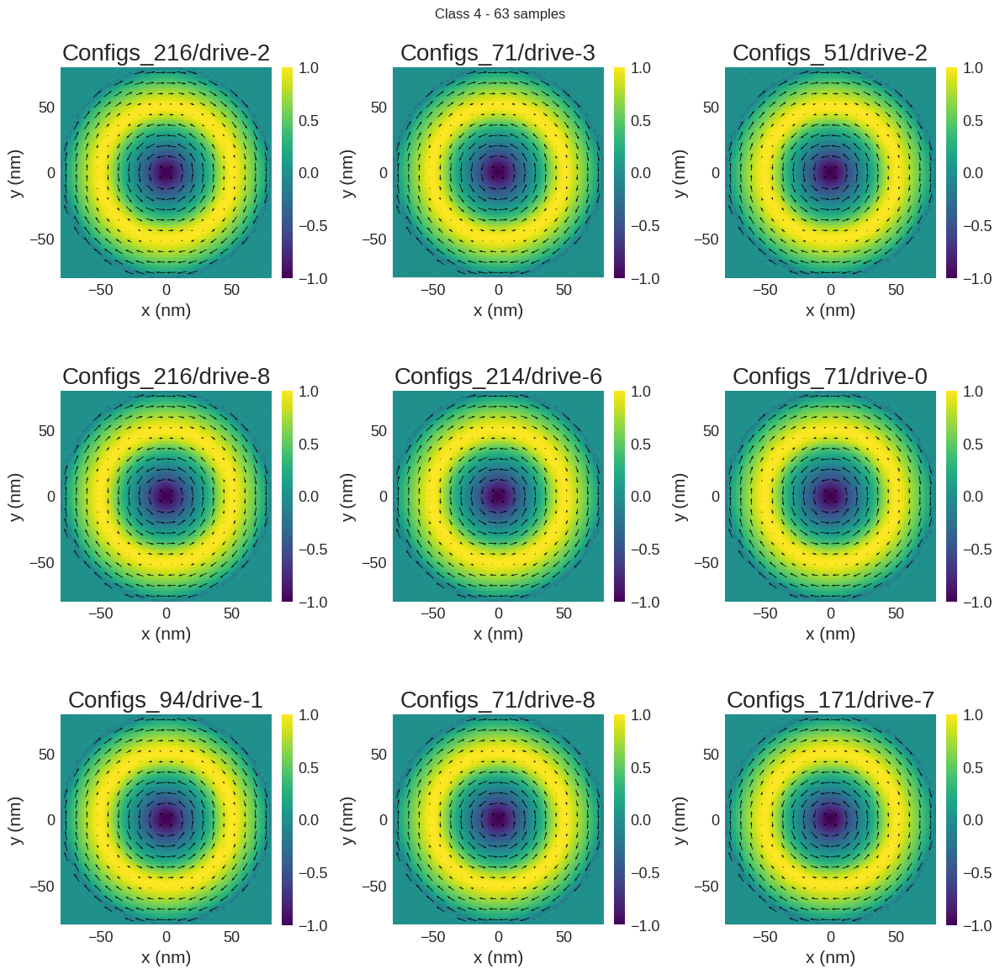

...

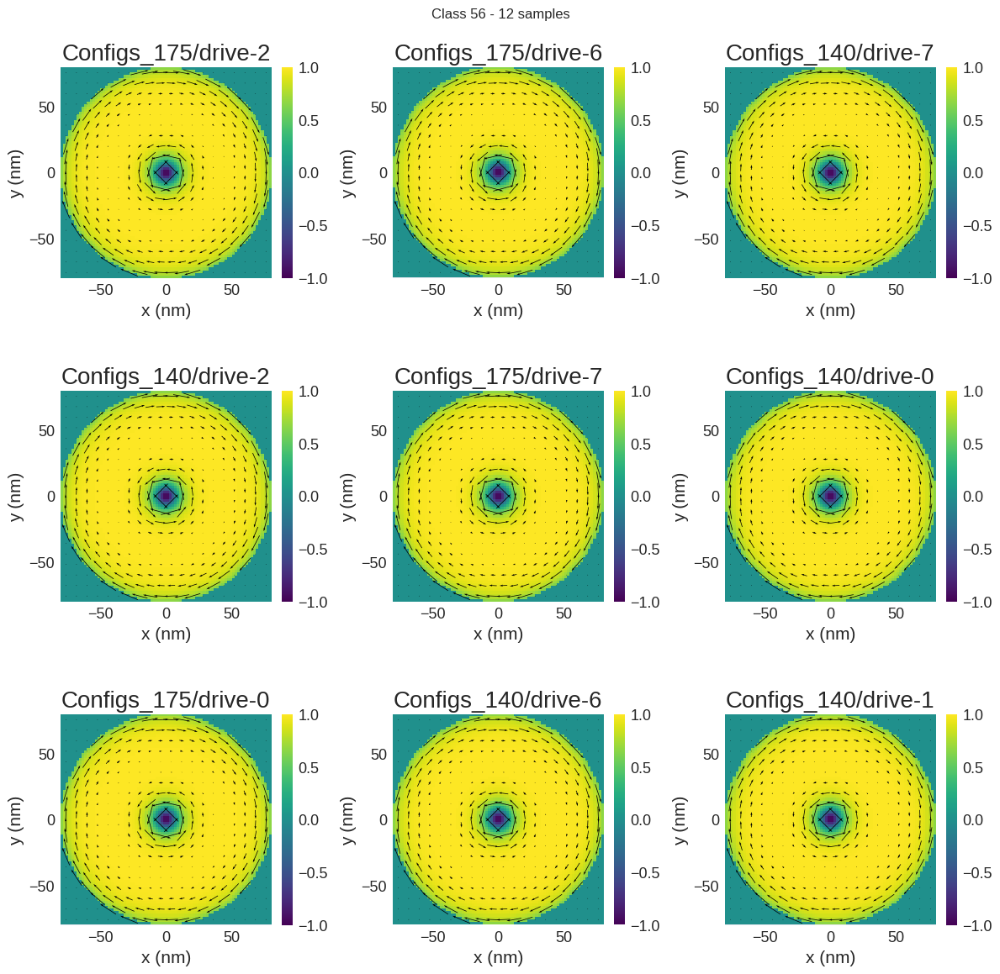

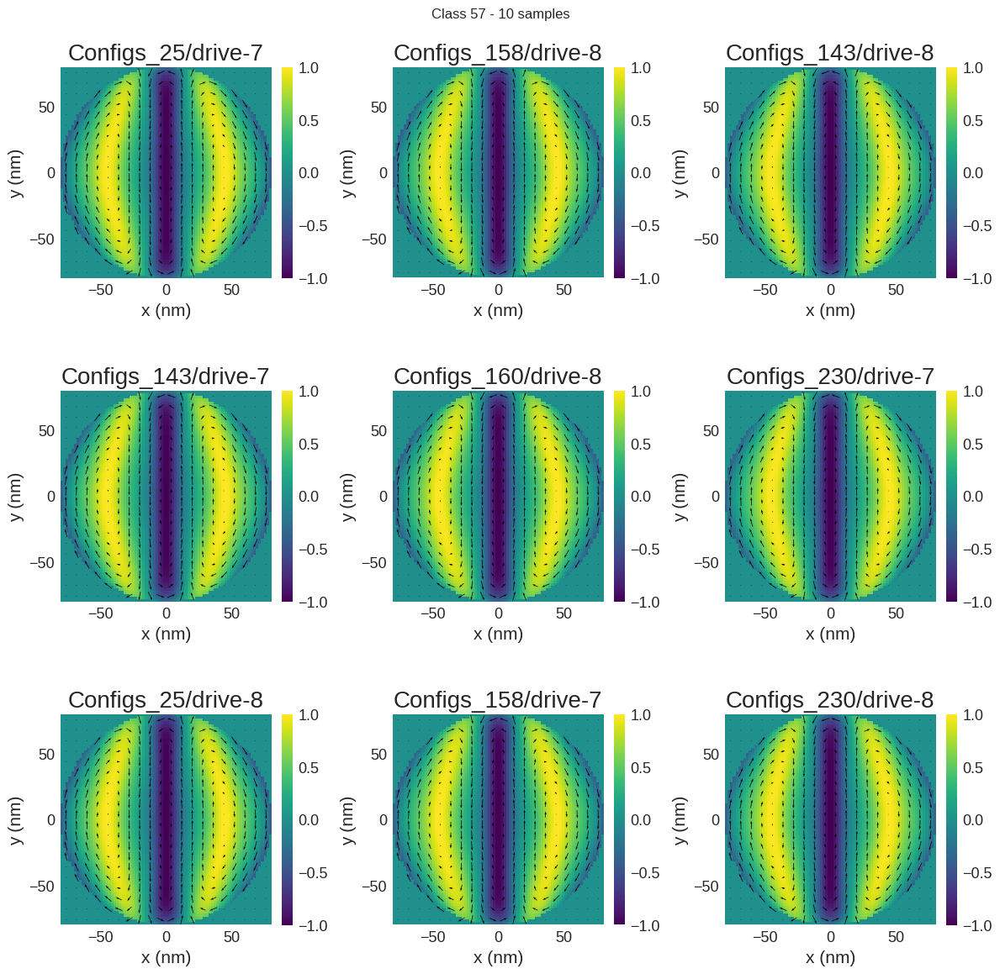

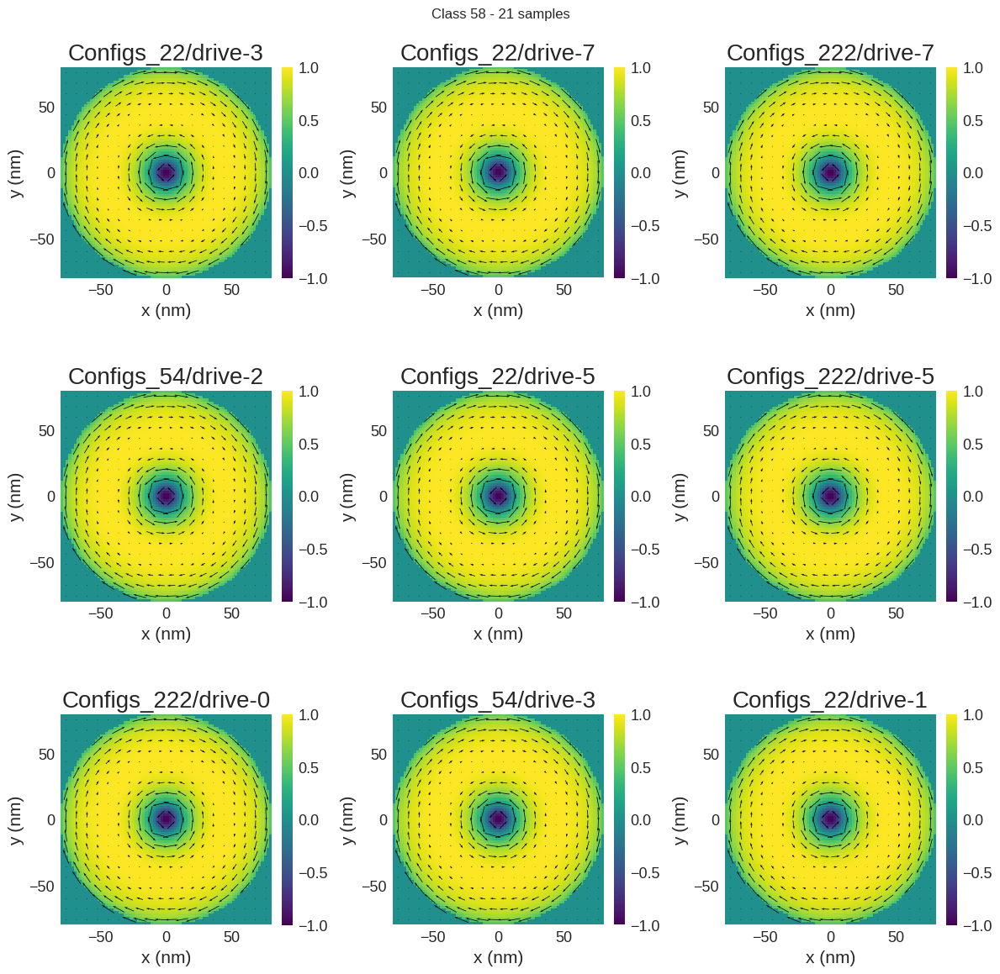

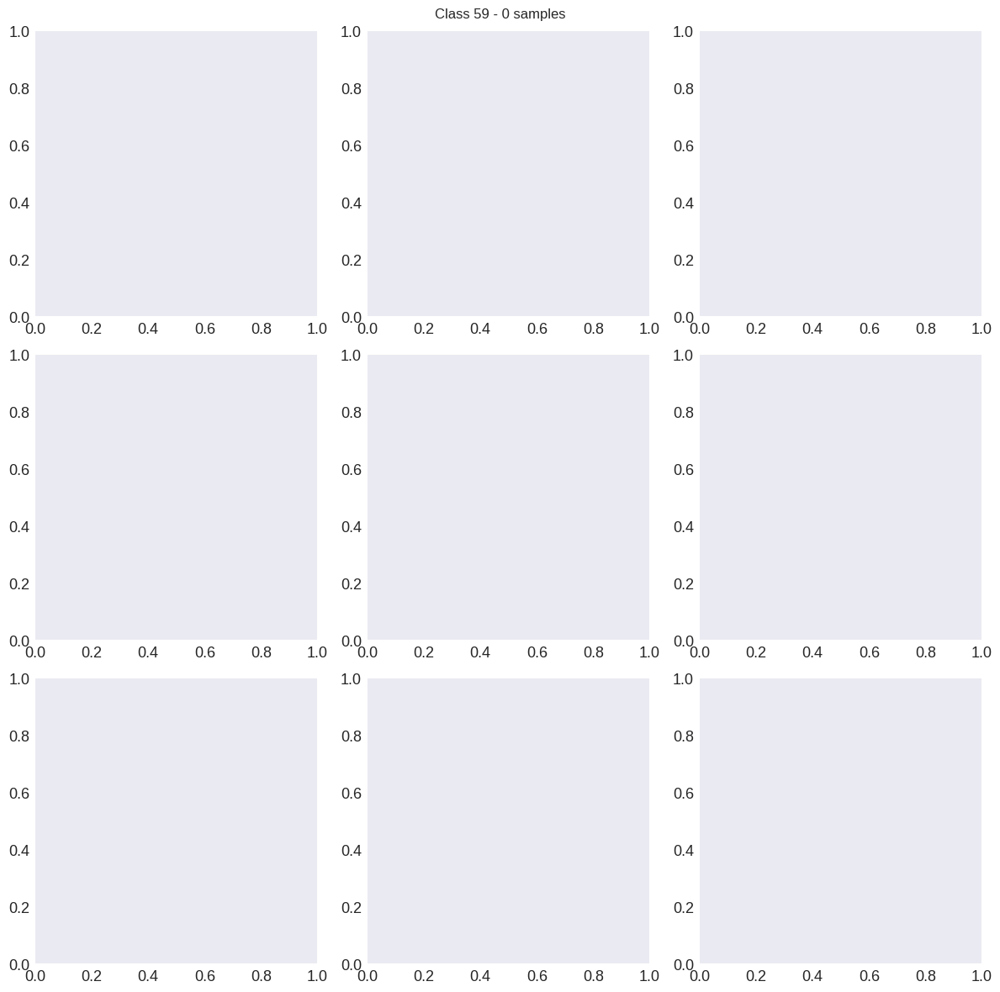

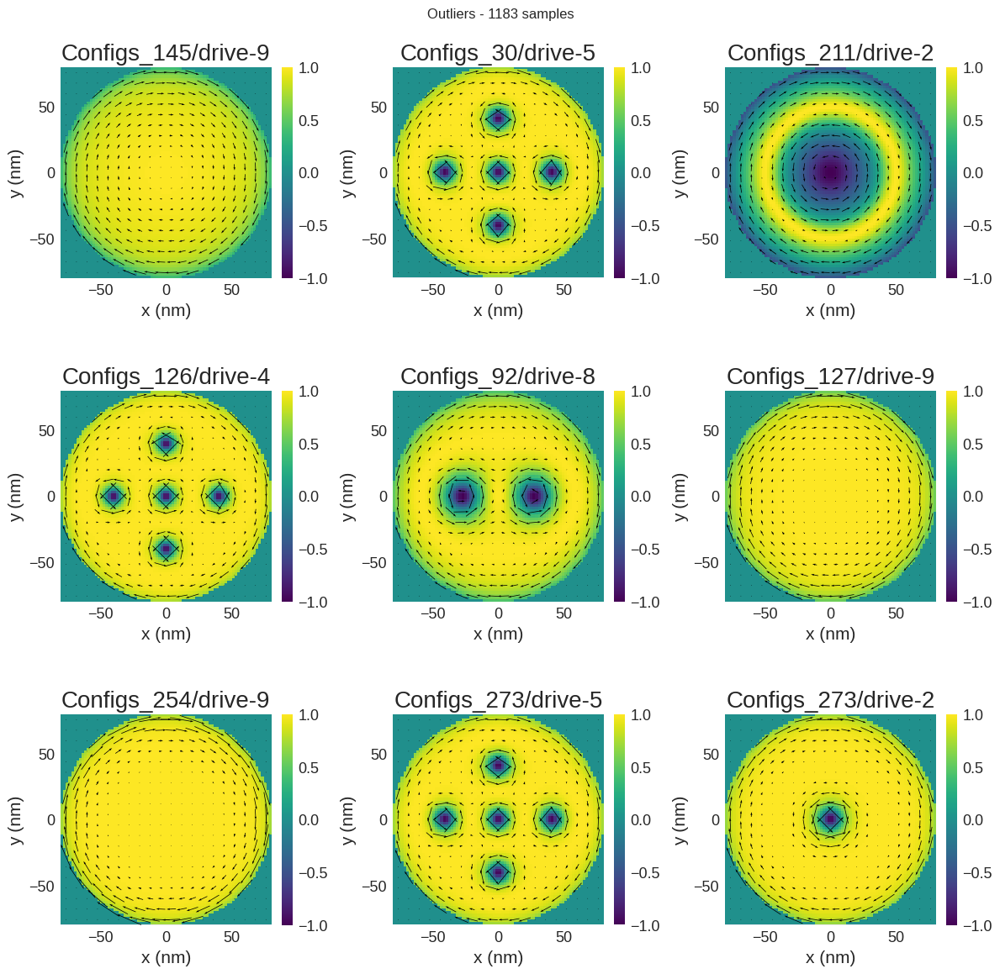

In [8]:
from plotting import plot_all_examples

plot_all_examples(class_dict, parameters_dict)